<a href="https://colab.research.google.com/github/soulirove/my-teasting-area/blob/main/lane_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [105]:
import numpy as np
import cv2
import pickle
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from ipywidgets import interact, interactive, fixed
from moviepy.editor import VideoFileClip
from IPython.display import HTML
import moviepy as mve

--2021-05-21 17:35:53--  http://deeplearning.iit.bme.hu/Carla_Videos.zip
Resolving deeplearning.iit.bme.hu (deeplearning.iit.bme.hu)... 152.66.243.112
Connecting to deeplearning.iit.bme.hu (deeplearning.iit.bme.hu)|152.66.243.112|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 547880046 (522M) [application/zip]
Saving to: ‘Carla_Videos.zip’

Carla_Videos.zip    100%[===================>] 522.50M  15.7MB/s    in 28s     

2021-05-21 17:36:22 (19.0 MB/s) - ‘Carla_Videos.zip’ saved [547880046/547880046]

replace carla_images/rgb/000/00.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
replace carla_images/rgb/000/01.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: A


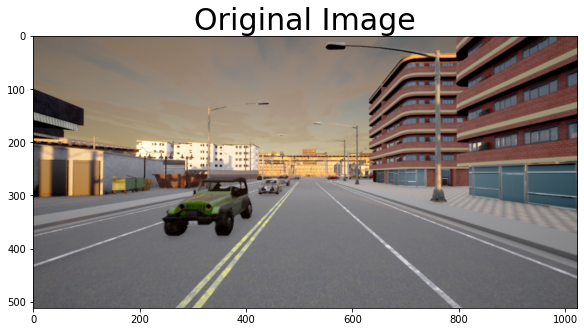

In [106]:
# Homework dataset
!wget http://deeplearning.iit.bme.hu/Carla_Videos.zip
!unzip -qq Carla_Videos.zip
!rm Carla_Videos.zip

# Read a test image
img = mpimg.imread("carla_images/rgb/000/00.jpg")
# Plot Original and Undistorted Test Image
plt.figure(figsize=(20,50))
plt.subplots_adjust(hspace = .2, wspace=.05)

# Plot Original Test Image
plt.subplot(1,2,1)
plt.title('Original Image', fontsize=30)
fig =plt.imshow(img)

# **Pespective Transform**

In [107]:
# capture image dimensions
img_size = (img.shape[1], img.shape[0])

#width and height
w = img.shape[1]
h = img.shape[0]

print(img_size)

(1024, 512)


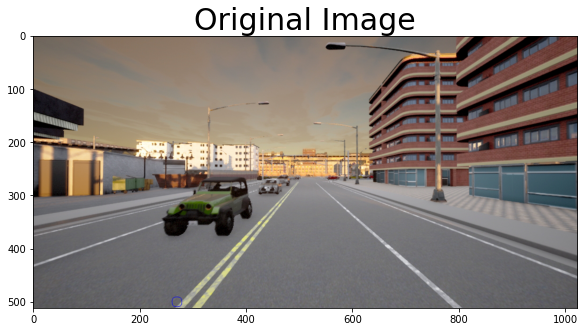

In [108]:
# Set parameter to source and destination point of views
top_right = (570, 300)
top_left = (470, 300)
botom_right = (850, 500)
botom_left = (270, 500)

cv2.circle(img, (270, 500), 10, (0,0,255), thickness=1, lineType=8, shift=0)
# Plot Original and Undistorted Test Image
plt.figure(figsize=(20,50))
plt.subplots_adjust(hspace = .2, wspace=.05)

# Plot Original Test Image
plt.subplot(1,2,1)
plt.title('Original Image', fontsize=30)
fig =plt.imshow(img)

In [109]:
# Set parameter to source and destination point of views
top_right = (570, 300)
top_left = (467, 300)
botom_right = (850, 500)
botom_left = (250, 500)
# Source
src = np.float32([[top_right],[top_left],[botom_right],[botom_left]])

# Destination
dst = np.float32([[w,0],[0,0],[w,h],[0,h]])

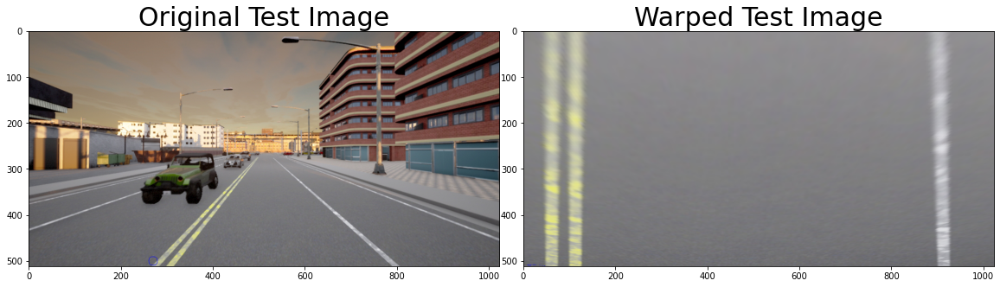

In [110]:
# Creating a Matriz form source and destination points and transform image
M = cv2.getPerspectiveTransform(src, dst)
warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
# Plot Original and Undistorted Test Image
plt.figure(figsize=(20,50))
plt.subplots_adjust(hspace = .2, wspace=.05)

# Plot Original Test Image
plt.subplot(1,2,1)
plt.title('Original Test Image', fontsize=30)
fig =plt.imshow(img)

# Plot Undistorted Test Image
plt.subplot(1,2,2)
plt.title('Warped Test Image', fontsize=30)
fig =plt.imshow(warped)

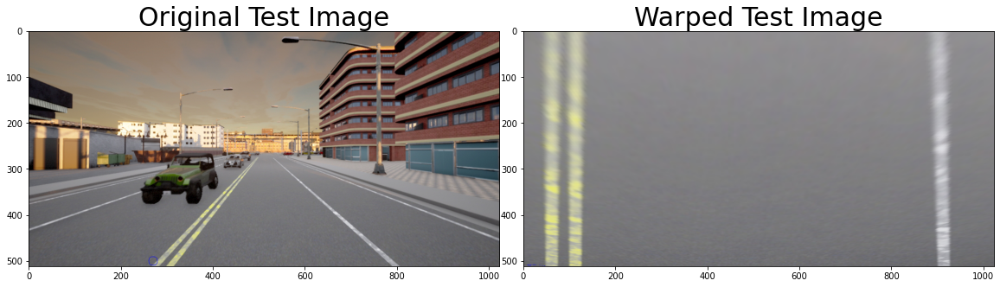

In [111]:
      
      
      
# Plot Original and Undistorted Test Image
plt.figure(figsize=(20,50))
plt.subplots_adjust(hspace = .2, wspace=.05)

# Plot Original Test Image
plt.subplot(1,2,1)
plt.title('Original Test Image', fontsize=30)
fig =plt.imshow(img)

# Plot Undistorted Test Image
plt.subplot(1,2,2)
plt.title('Warped Test Image', fontsize=30)
fig =plt.imshow(warped)

### **Creating a Warped Function to transform perspective given a image and source point**


In [112]:
def warped(img, top_right, top_left, botom_right, botom_left):
        
    #extract image dimensions
    img_size = (img.shape[1], img.shape[0])
    #set source points
    src = np.float32([[top_right],[top_left],[botom_right],[botom_left]])
    #define width and height
    w, h = img.shape[1], img.shape[0]
    #set destination points
    dst = np.float32([[w,0],[0,0],[w,h],[0,h]])
    # get a perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # get inverse matrix
    Minv = cv2.getPerspectiveTransform(dst, src)
    # warp original image
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    #return warped image and inverse matrix
    return warped, Minv

[[ 1.00585938e-01 -8.28287760e-01  4.67000000e+02]
 [ 0.00000000e+00 -4.18294271e-01  3.00000000e+02]
 [ 0.00000000e+00 -1.61783854e-03  1.00000000e+00]]


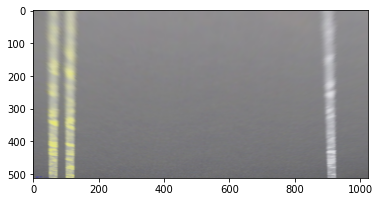

In [113]:
#testing warped function
img_warped, Minv = warped( img , top_right,top_left,botom_right, botom_left)

#rwarped image
print(Minv)
plt.imshow(img_warped)

## **Thresholded Gradient**

## **first we will check the output for each color channel to know which channels will we use to represent the lane lines in the image.**
### check the output for each color channel.

### read in and make a list of calibration images  

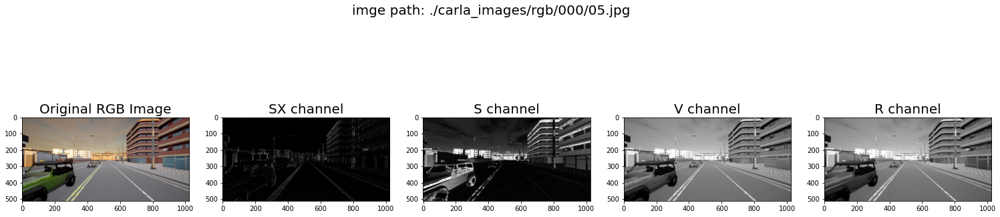

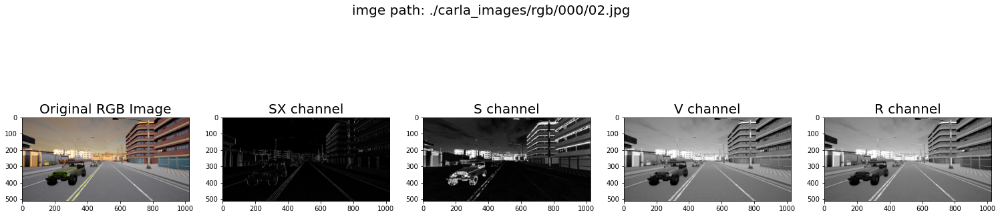

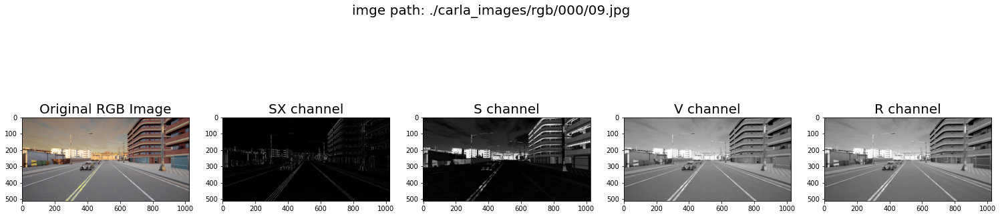

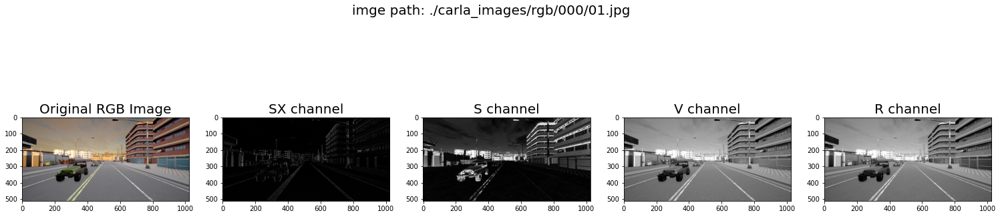

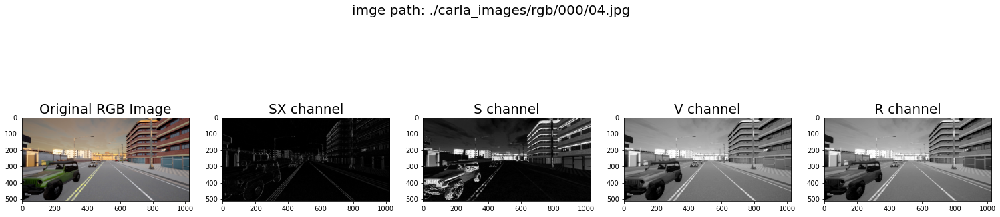

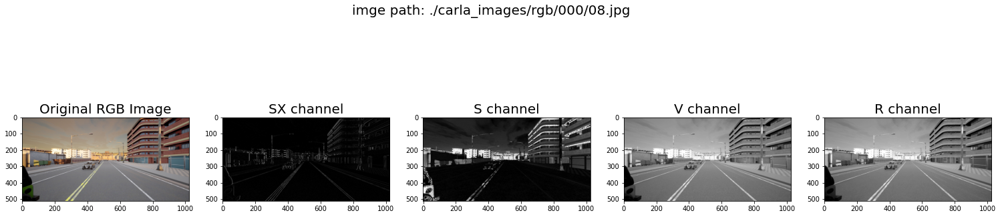

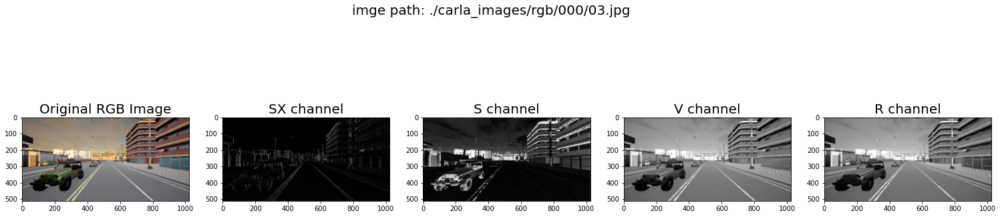

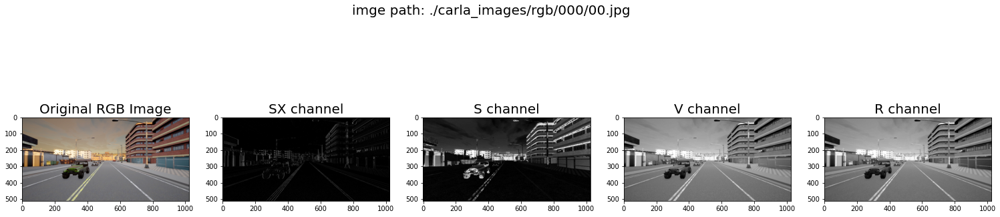

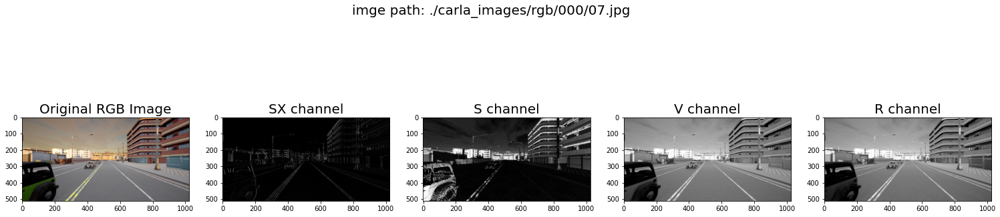

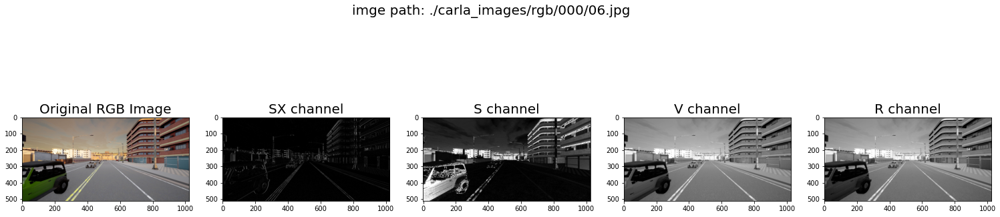

In [149]:
test_images_path = glob.glob('./carla_images/rgb/000/0*.jpg')

for img_full_path in test_images_path:
    #read in each image
    img = mpimg.imread(img_full_path)
    
    #undistort and unwarp the image 
    top_down_img, Minv  = warped(img, top_right,top_left,botom_right, botom_left)
    
    processed_image = top_down_img
    
    r_channel = img[:,:,0]
    
    #Convert to HLS color space and separate the S channel 
    hls = cv2.cvtColor(img,cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    
    #Convert to HLS color space and separate the V channel 
    hsv = cv2.cvtColor(img,cv2.COLOR_RGB2HSV)
    V_channel = hsv[:,:,2]
    
    #Sobel x
    sobelx = cv2.Sobel(r_channel,cv2.CV_64F,1,0)#Take the derivative in x to get only vertival lines 
    abs_sobelx = np.absolute(sobelx) #Absolute x derivative to accentuate lines away from horizontal 
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    
    #print the images 
    fig = plt.figure(figsize=(26,12))
    fig.suptitle('imge path: '+str(img_full_path),fontsize=20)
    plt.subplot(151)# 1 row, 2 cols, and this is the first figure
    plt.imshow(img)
    plt.title('Original RGB Image',fontsize=20)
    
    plt.subplot(152)# 1 row, 2 cols, and this is the first figure
    plt.imshow(scaled_sobel, cmap='gray')
    plt.title('SX channel',fontsize=20)
    
    plt.subplot(153)# 1 row, 2 cols, and this is the first figure
    plt.imshow(s_channel, cmap='gray')
    plt.title('S channel',fontsize=20)

    plt.subplot(154)# 1 row, 2 cols, and this is the first figure
    plt.imshow(V_channel, cmap='gray')
    plt.title('V channel',fontsize=20)

    plt.subplot(155)# 1 row, 2 cols, and this is the first figure
    plt.imshow(r_channel, cmap='gray')
    plt.title('R channel',fontsize=20)
    
    plt.subplots_adjust(top=1.3)
    plt.show()

### The Sobel **operator**

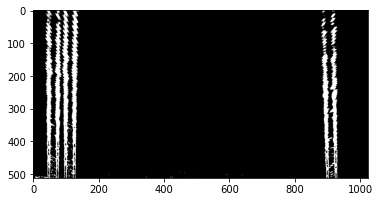

In [115]:
#transform in gray scale
gray = cv2.cvtColor(img_warped, cv2.COLOR_RGB2GRAY)

#aplying CV2 Sobel
sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
#Take the absolute value of the output from cv2.Sobel()
abs_sobelx = np.absolute(sobelx)
# Scale the result to an 8-bit range (0-255)
scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))

# Apply lower and upper thresholds
thresh_min = 20
thresh_max = 100

# Create binary_output
sxbinary = np.zeros_like(scaled_sobel)
sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
plt.imshow(sxbinary, cmap='gray')

### Creating a Absolute Sober Threshold Function

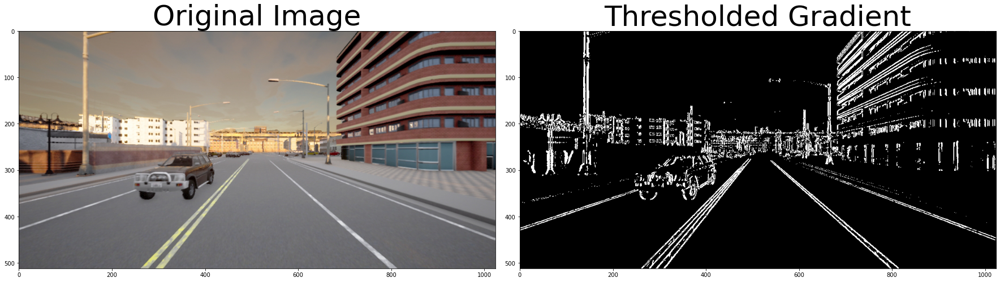

In [116]:
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Return the result
    return binary_output
    
# Run the function
grad_binary = abs_sobel_thresh(img, orient='x', thresh_min=20, thresh_max=100)
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(grad_binary, cmap='gray')
ax2.set_title('Thresholded Gradient', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### **Creating a Magnitude Threshold Function**


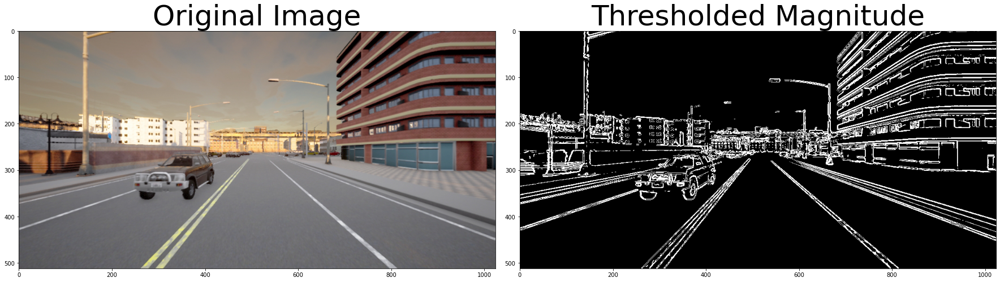

In [117]:
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    
    return binary_output

# Run the function
mag_binary = mag_thresh(img, sobel_kernel=3, mag_thresh=(30, 100))
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(mag_binary, cmap='gray')
ax2.set_title('Thresholded Magnitude', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### **Creating a Direction Threshold Function**


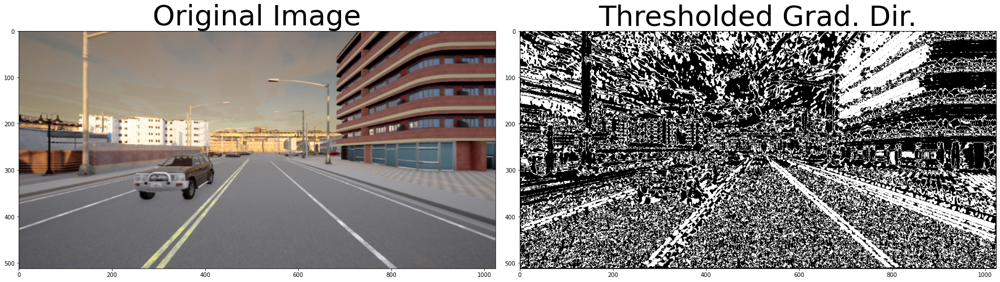

In [118]:
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    return binary_output
    
# Run the function
dir_binary = dir_threshold(img, sobel_kernel=15, thresh=(0.7, 1.3))
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(dir_binary, cmap='gray')
ax2.set_title('Thresholded Grad. Dir.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


### **Combining the Results**

In [119]:
# Apply each of the thresholding functions
gradx = abs_sobel_thresh(img, orient='x', thresh_min=20, thresh_max=100)
grady = abs_sobel_thresh(img, orient='y', thresh_min=20, thresh_max=100)
mag_binary = mag_thresh(img, sobel_kernel=3, mag_thresh=(30, 100))
dir_binary = dir_threshold(img, sobel_kernel=15, thresh=(0.7, 1.3))

In [120]:
#combining results
combined = np.zeros_like(dir_binary)
combined[((gradx == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1

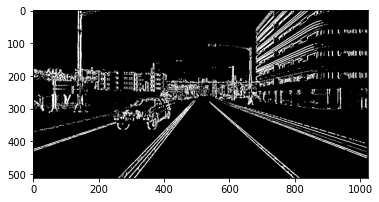

In [121]:
plt.imshow(combined, cmap='gray')

# **Color Spaces**

it is obvious that the S channel best represnts the lane lines, and with the help of the SX derivative image, we will generate a very good binary image that has all the details we want about the lanes. now we are going to play with the threshold values for S-channel, and SX channel to get the best binary image. 


### Creating a HSL Select Color Function

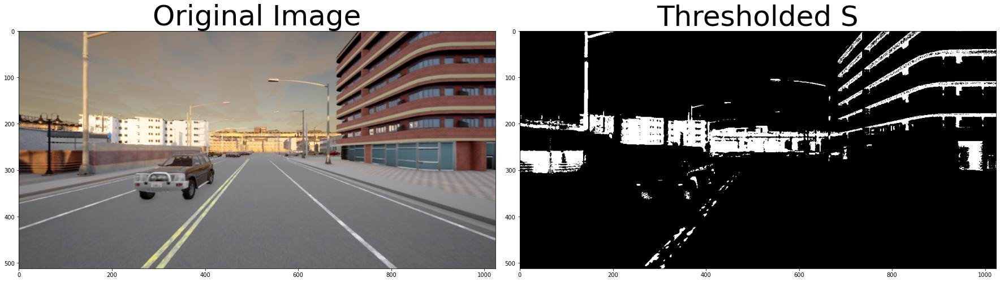

In [122]:
def hls_select(img, thresh=(0, 255)):
    #converting from RBG to HLS
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    #S channel
    s_channel = hls[:,:,2]
    #creating a binary output using S channel
    binary_output = np.zeros_like(s_channel)
    binary_output[(s_channel > thresh[0]) & (s_channel <= thresh[1])] = 1
    return binary_output

#testing function    
hls_binary = hls_select(img, thresh=(90, 255))

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(hls_binary, cmap='gray')
ax2.set_title('Thresholded S', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Testign Combined Thresholds


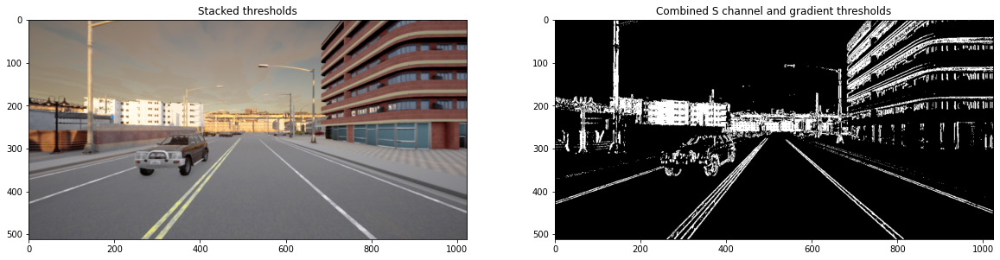

In [123]:
# Convert to HLS color space and separate the S channel
# Note: img is the undistorted image
hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
s_channel = hls[:,:,2]

# Grayscale image
# NOTE: we already saw that standard grayscaling lost color information for the lane lines
# Explore gradients in other colors spaces / color channels to see what might work better
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

# Sobel x
sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))

# Threshold x gradient
thresh_min = 20
thresh_max = 100
sxbinary = np.zeros_like(scaled_sobel)
sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

# Threshold color channel
s_thresh_min = 170
s_thresh_max = 255
s_binary = np.zeros_like(s_channel)
s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1

# Stack each channel to view their individual contributions in green and blue respectively
# This returns a stack of the two binary images, whose components you can see as different colors
color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary))

# Combine the two binary thresholds
combined_binary = np.zeros_like(sxbinary)
combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1

# Plotting thresholded images
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.set_title('Stacked thresholds')
ax1.imshow(img)

ax2.set_title('Combined S channel and gradient thresholds')
ax2.imshow(combined_binary, cmap='gray')

### Creating a Function to create a binary output from Color and Gradients Thresholds


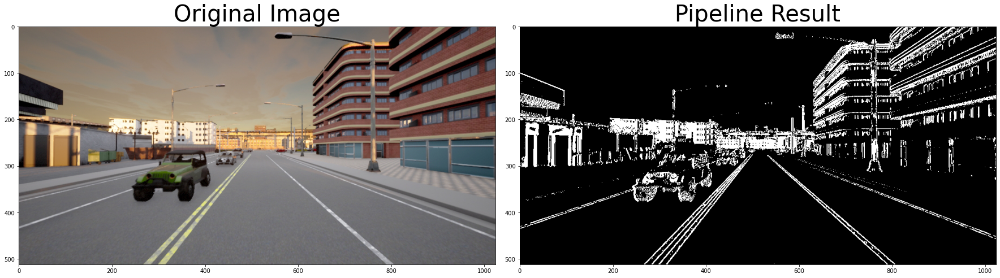

In [124]:
def color_and_gradient_threshold(img):
    
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]

    # Grayscale image
    # NOTE: we already saw that standard grayscaling lost color information for the lane lines
    # Explore gradients in other colors spaces / color channels to see what might work better
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))

    # Threshold x gradient
    thresh_min = 20
    thresh_max = 100
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Threshold color channel
    s_thresh_min = 170
    s_thresh_max = 255
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1

    # Stack each channel to view their individual contributions in green and blue respectively
    # This returns a stack of the two binary images, whose components you can see as different colors
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary))

    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1

    return combined_binary

image = mpimg.imread("carla_images/rgb/000/00.jpg")
    
result = color_and_gradient_threshold(image)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()

ax1.imshow(image)
ax1.set_title('Original Image', fontsize=40)

ax2.imshow(result, cmap='gray')
ax2.set_title('Pipeline Result', fontsize=40)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [125]:
#Read test images names
images = glob.glob('./carla_images/rgb/000/*.jpg')

#print names
for i in range(len(images)):
    print("Imagem ", i, ": " ,images[i] )

Imagem  0 :  ./carla_images/rgb/000/59.jpg
Imagem  1 :  ./carla_images/rgb/000/57.jpg
Imagem  2 :  ./carla_images/rgb/000/14.jpg
Imagem  3 :  ./carla_images/rgb/000/90.jpg
Imagem  4 :  ./carla_images/rgb/000/05.jpg
Imagem  5 :  ./carla_images/rgb/000/68.jpg
Imagem  6 :  ./carla_images/rgb/000/88.jpg
Imagem  7 :  ./carla_images/rgb/000/48.jpg
Imagem  8 :  ./carla_images/rgb/000/76.jpg
Imagem  9 :  ./carla_images/rgb/000/29.jpg
Imagem  10 :  ./carla_images/rgb/000/86.jpg
Imagem  11 :  ./carla_images/rgb/000/78.jpg
Imagem  12 :  ./carla_images/rgb/000/28.jpg
Imagem  13 :  ./carla_images/rgb/000/32.jpg
Imagem  14 :  ./carla_images/rgb/000/82.jpg
Imagem  15 :  ./carla_images/rgb/000/02.jpg
Imagem  16 :  ./carla_images/rgb/000/33.jpg
Imagem  17 :  ./carla_images/rgb/000/67.jpg
Imagem  18 :  ./carla_images/rgb/000/09.jpg
Imagem  19 :  ./carla_images/rgb/000/41.jpg
Imagem  20 :  ./carla_images/rgb/000/13.jpg
Imagem  21 :  ./carla_images/rgb/000/61.jpg
Imagem  22 :  ./carla_images/rgb/000/83.jp

## Creating a Function to give us a Binary Warped Image


In [126]:
def binary(img):
    
    global objpoints
    global imgpoints
    global top_right
    global top_left
    global botom_right
    global botom_left
    

    
    #Aplying Thresholds
    color_and_gradient = color_and_gradient_threshold(img)
    
    #Perspective Transform
    result, Minv = warped(color_and_gradient, top_right, top_left, botom_right, botom_left)
    
    return result, Minv

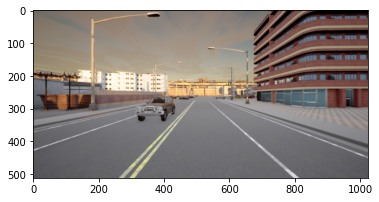

In [127]:

#Randomly choosing a image
choice = np.random.choice(len(images))

#read image
img = mpimg.imread(images[choice])
plt.imshow(img)

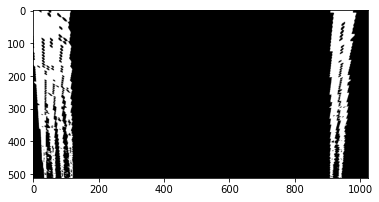

In [128]:
# Test Binary Function
binary_warped, Minv = binary(img)

plt.imshow(binary_warped, cmap="gray")

### Detecting Lanes using Histogram


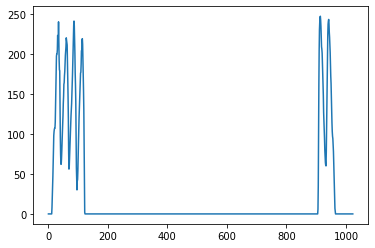

In [129]:
import numpy as np
histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
plt.plot(histogram)

## **Sliding Window**


In [130]:
histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
# Create an output image to draw on and  visualize the result
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
# Find the peak of the left and right halves of the histogram
# These will be the starting point for the left and right lines
midpoint = np.int(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

# Choose the number of sliding windows
nwindows = 13
# Set height of windows
window_height = np.int(binary_warped.shape[0]/nwindows)
# Identify the x and y positions of all nonzero pixels in the image
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
# Current positions to be updated for each window
leftx_current = leftx_base
rightx_current = rightx_base
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50
# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

# Step through the windows one by one
for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = binary_warped.shape[0] - (window+1)*window_height
    win_y_high = binary_warped.shape[0] - window*window_height
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
    (0,255,0), 2) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
    (0,255,0), 2) 
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
    (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
    (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds) > minpix:        
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

# Concatenate the arrays of indices
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)

# Extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds] 

# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

## **Visualization**

(510.0, 0.0)

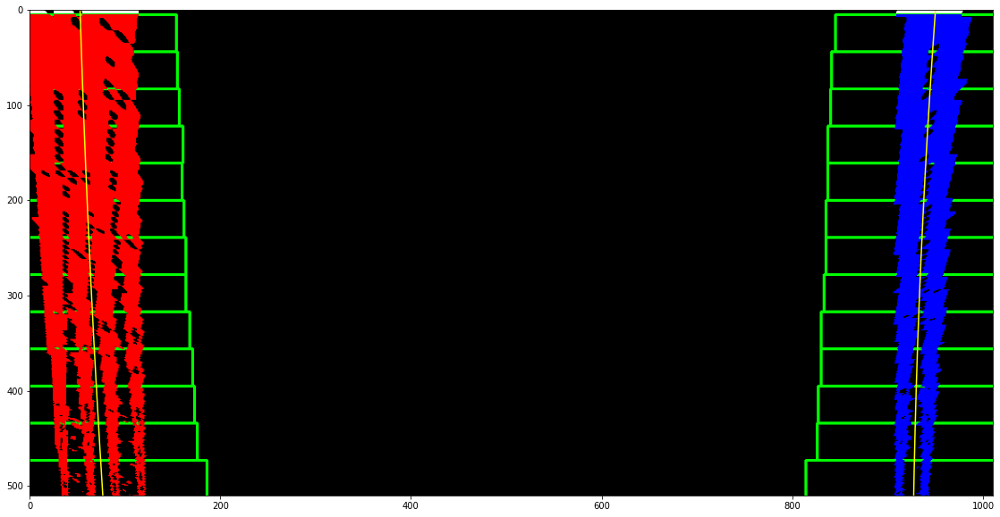

In [131]:
# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
plt.figure(figsize=(20,10))
plt.imshow(out_img)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1010)
plt.ylim(510, 0)

In [132]:
# Assume you now have a new warped binary image 
# from the next frame of video (also called "binary_warped")
# It's now much easier to find line pixels!
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
margin = 100
left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
left_fit[1]*nonzeroy + left_fit[2] + margin))) 

right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
right_fit[1]*nonzeroy + right_fit[2] + margin)))  

# Again, extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds]
# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)
# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
try:
  left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
  right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
except TypeError:
  #avoids an error if left and right_fit are still none or incorrect 
  print('the function failed to fit a line!')
  left_fitx = 1*ploty**2 + 1*ploty
  right_fitx = 1*ploty**2 + 1*ploty

(510.0, 0.0)

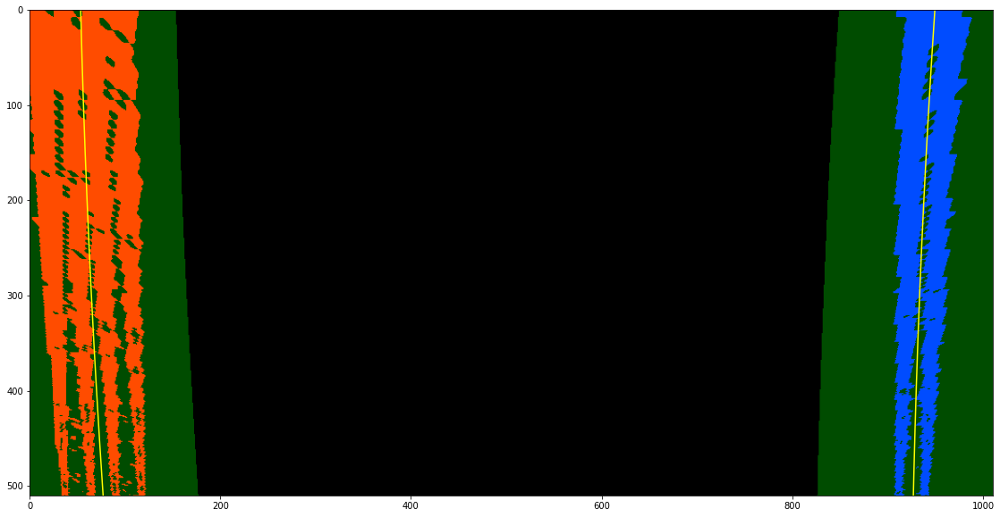

In [133]:
# Create an image to draw on and an image to show the selection window
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
window_img = np.zeros_like(out_img)
# Color in left and right line pixels
out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

# Generate a polygon to illustrate the search window area
# And recast the x and y points into usable format for cv2.fillPoly()
left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
left_line_pts = np.hstack((left_line_window1, left_line_window2))
right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
right_line_pts = np.hstack((right_line_window1, right_line_window2))

# Draw the lane onto the warped blank image
cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
plt.figure(figsize=(20,10))
plt.imshow(result)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1010)
plt.ylim(510, 0)

## **Creating a Function to Fitlines given a Binary Warped Image**


In [134]:
def fitlines(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    
   
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    
    
    # Fit a second order polynomial to each
    if len(leftx) == 0:
        left_fit =[]
    else:
        left_fit = np.polyfit(lefty, leftx, 2)
    
    if len(rightx) == 0:
        right_fit =[]
    else:
        right_fit = np.polyfit(righty, rightx, 2)
    

    
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )



    return left_fit, right_fit,out_img, lefty, leftx, righty, rightx, ploty

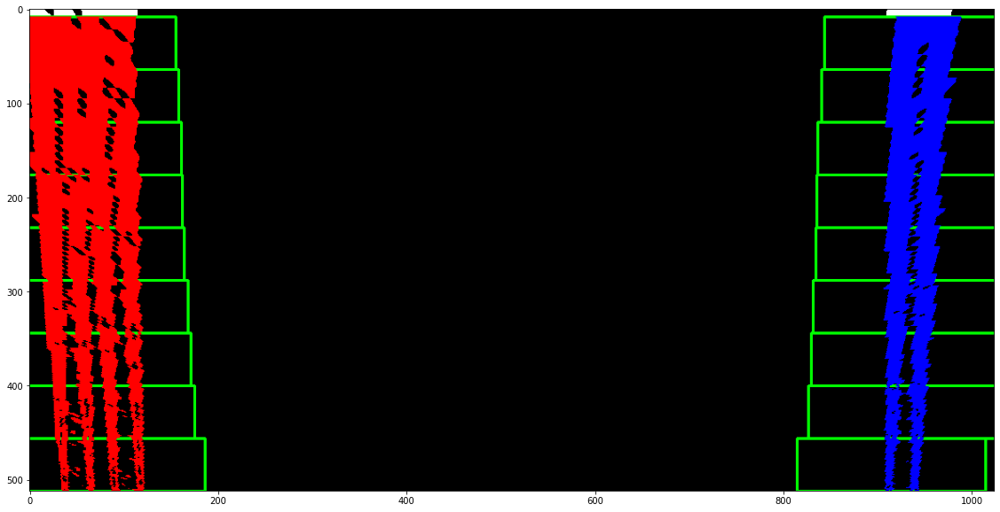

In [135]:
# Testing Fitlines Function
left_fit, right_fit,out_img, lefty, leftx, righty, rightx, ploty = fitlines(binary_warped)

# Plot Result
plt.figure(figsize=(20,10))
plt.imshow(out_img)

## **Creating a Function to Calculate Left and Rigth lanes curvature**

In [136]:
def curvatures(lefty, leftx, righty, rightx,left_fitx,right_fitx, ploty):
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 37/730 # meters per pixel in y dimension
    xm_per_pix = 3/720 # meters per pixel in x dimension
    
    y_eval = np.max(ploty)

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])

    camera_center = (left_fitx[-1]+right_fitx[-1]/2)
    center_diff = sum(camera_center - binary_warped[1]/2)* xm_per_pix
        
    side_pos = 'left'
    if center_diff <= 0:
        side_pos ='right'

    return left_curverad/1000, right_curverad/1000, center_diff/1000, side_pos

#Testing Function
left_curverad, right_curverad, center_diff, side_pos = curvatures(lefty, leftx, righty, rightx,left_fitx,right_fitx, ploty)
    
# Now our radius of curvature is in meters
print(left_curverad, 'mm', right_curverad, 'mm', center_diff, 'mm', side_pos)

11.33494599463785 mm 5.130886152845457 mm 2.306591524555509 mm left


## **Creating a Function to Draw Lane**


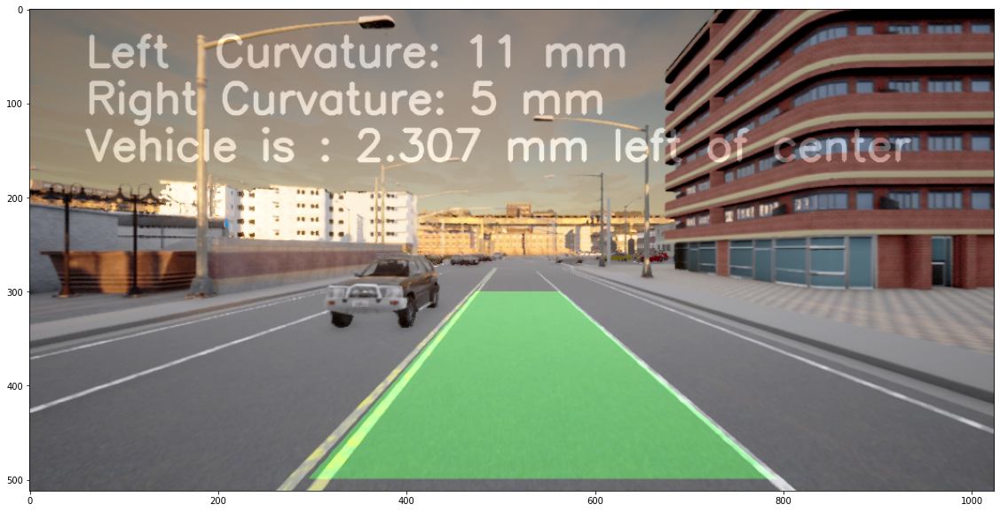

In [137]:
def draw_lane(img, warped, left_fit, right_fit, ploty, left_curverad, right_curverad, Minv):

    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    
    # Creating Text and set font parameters
    TextL = "Left  Curvature: " + str(int(left_curverad)) + " mm"
    TextR = "Right Curvature: " + str(int(right_curverad))+ " mm"
    TextC = 'Vehicle is : ' + str(round(center_diff,3)) + ' mm ' + side_pos + ' of center'
    fontScale=1.5
    thickness=3
    fontFace = cv2.FONT_HERSHEY_SIMPLEX

    # Using CV2 putText to write text into images
    cv2.putText(newwarp, TextL, (60,60), fontFace, fontScale,(255,255,255), thickness,  lineType = cv2.LINE_AA)
    cv2.putText(newwarp, TextR, (60,110), fontFace, fontScale,(255,255,255), thickness,  lineType = cv2.LINE_AA)
    cv2.putText(newwarp, TextC, (60,160), fontFace, fontScale,(255,255,255), thickness,  lineType = cv2.LINE_AA)

    # Combine the result with the original image
    result = cv2.addWeighted(img, 1, newwarp, 0.3, 0)
    
    return result

# Testing the Function
drawed_lane = draw_lane(img, binary_warped, left_fit, right_fit, ploty, left_curverad, right_curverad, Minv)

# Plot the Result
plt.figure(figsize=(20,10))
plt.imshow(drawed_lane)

# **Creating a Pipeline Function**

In [138]:
def pipeline(img):
    
    # creating a Binary Undistorced Warped Image
    binary_warped, Minv = binary(img)
    
    # Fiting Lines
    left_fit, right_fit,out_img, lefty, leftx, righty, rightx, ploty = fitlines(binary_warped)    
    
    # Calulating the left and right lines curvatures
    left_curverad, right_curverad,center_diff, side_pos = curvatures(lefty, leftx, righty, rightx,left_fitx,right_fitx, ploty)
    
    # Draw Lane between road lines
    result_lane = draw_lane(img, binary_warped, left_fit, right_fit, ploty, left_curverad, right_curverad, Minv)

    return result_lane

## Testing Pipeline

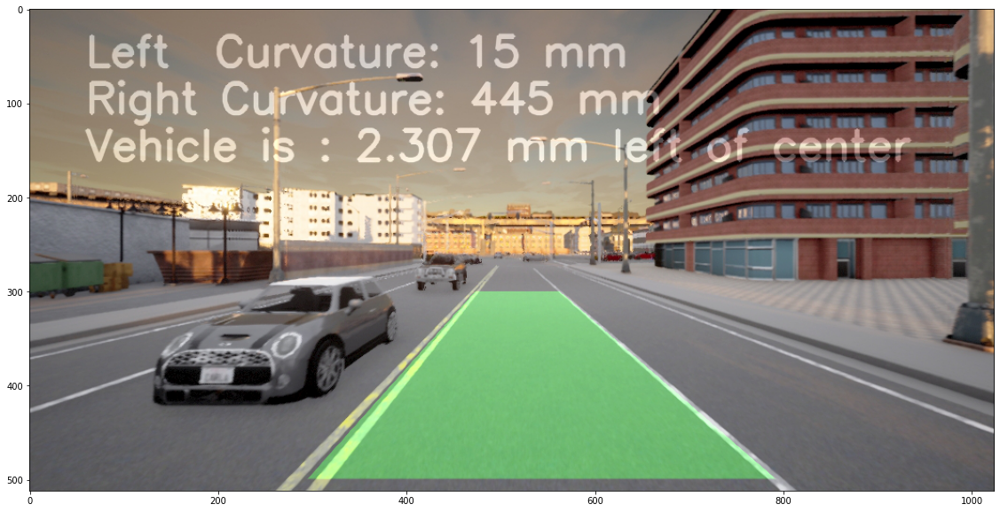

In [139]:
#Randomly choosing a image
choice = np.random.choice(len(images))

#read image
img = mpimg.imread(images[choice])
result = pipeline(img)
plt.figure(figsize=(20,10))
plt.imshow(result)

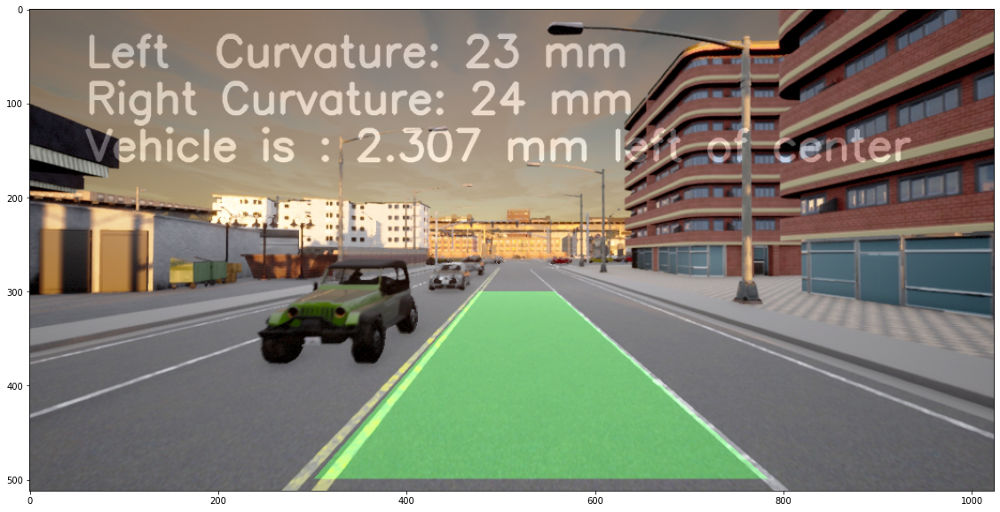

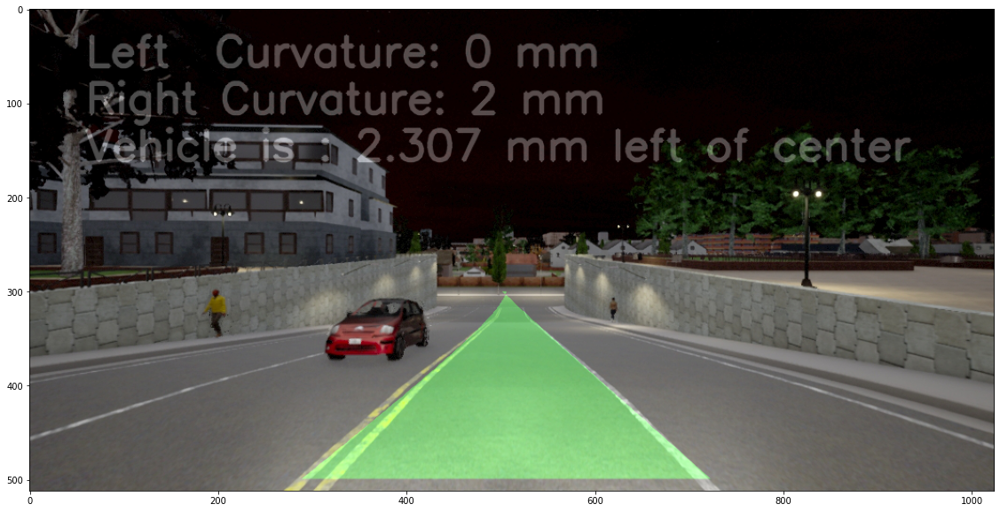

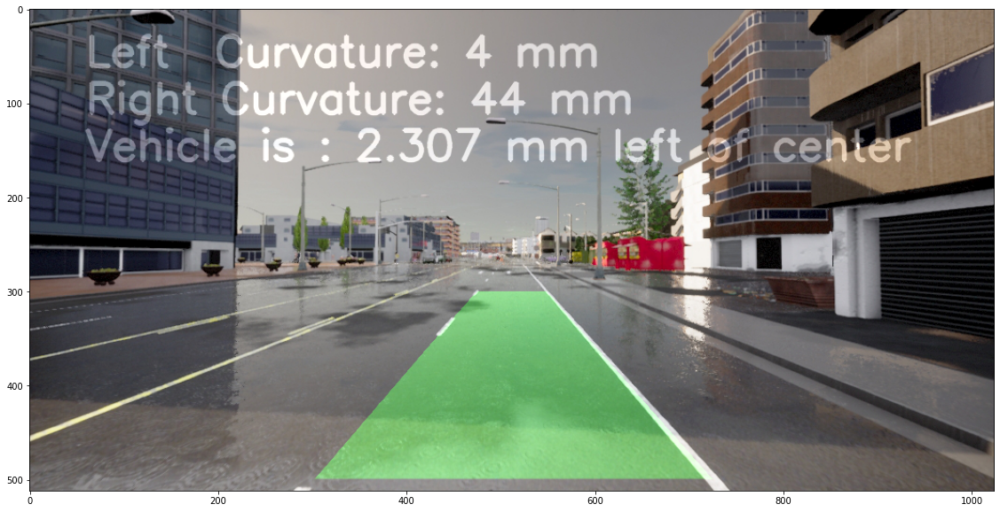

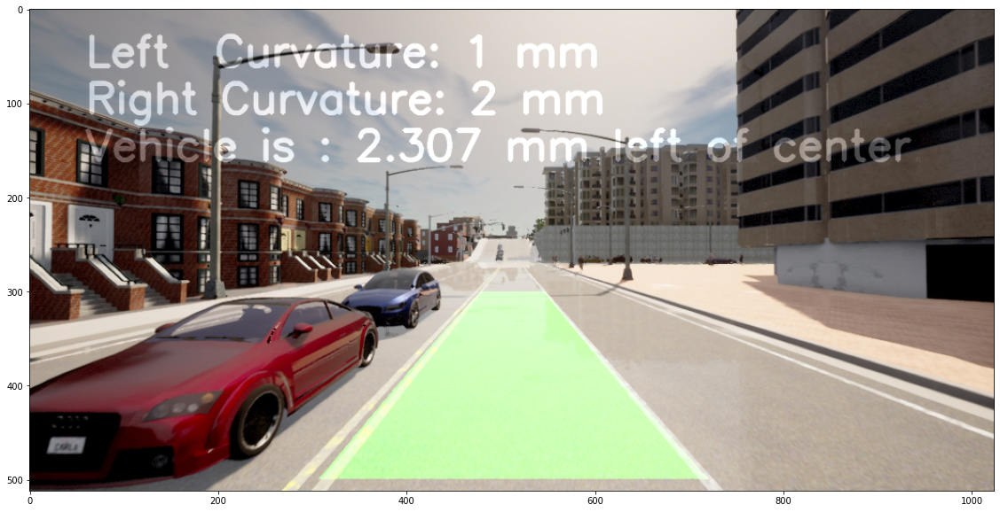

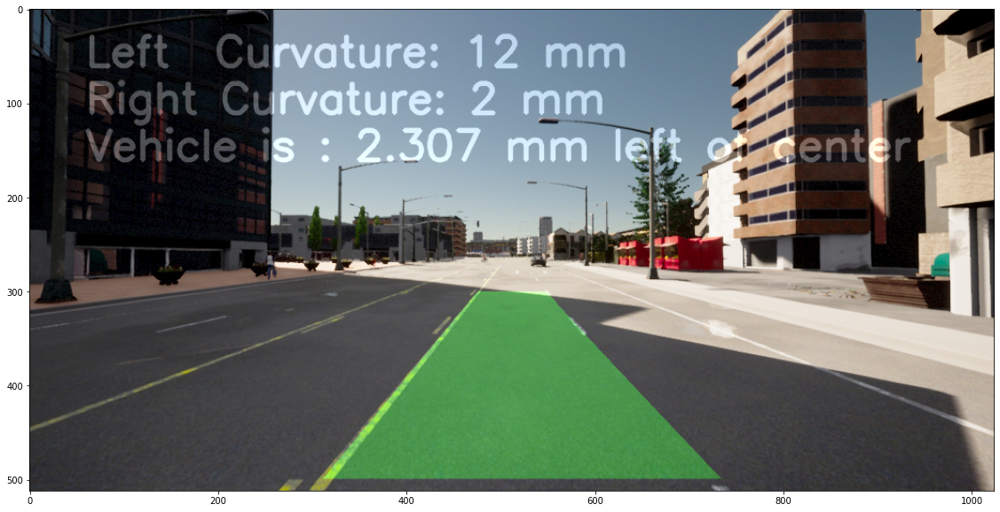

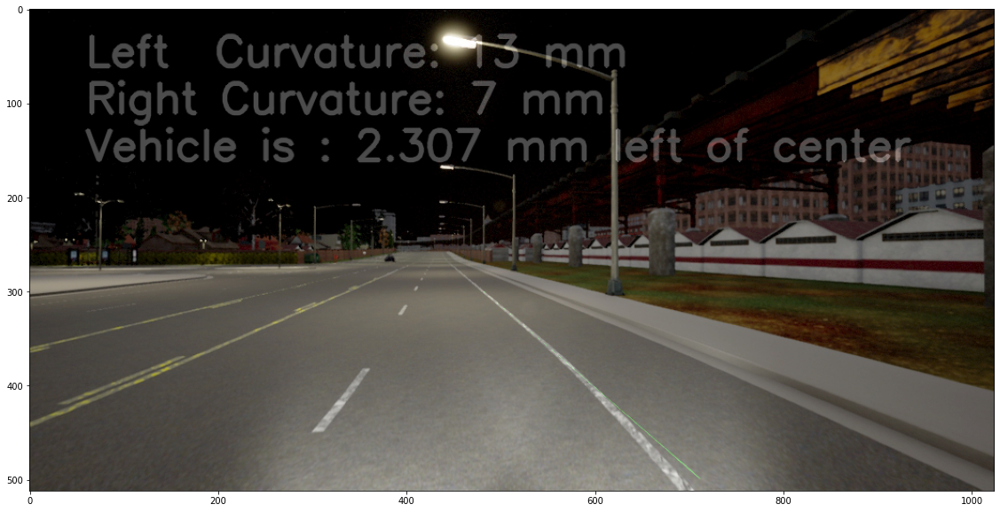

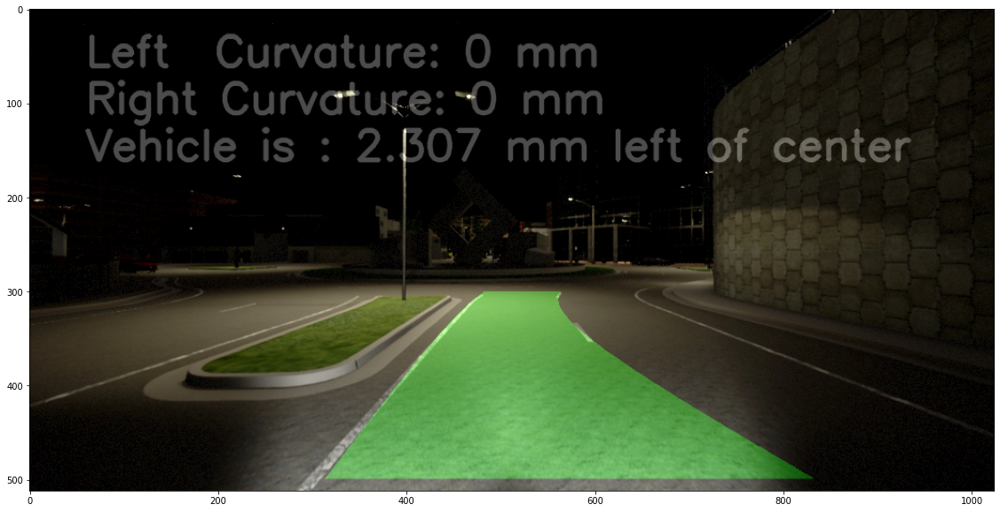

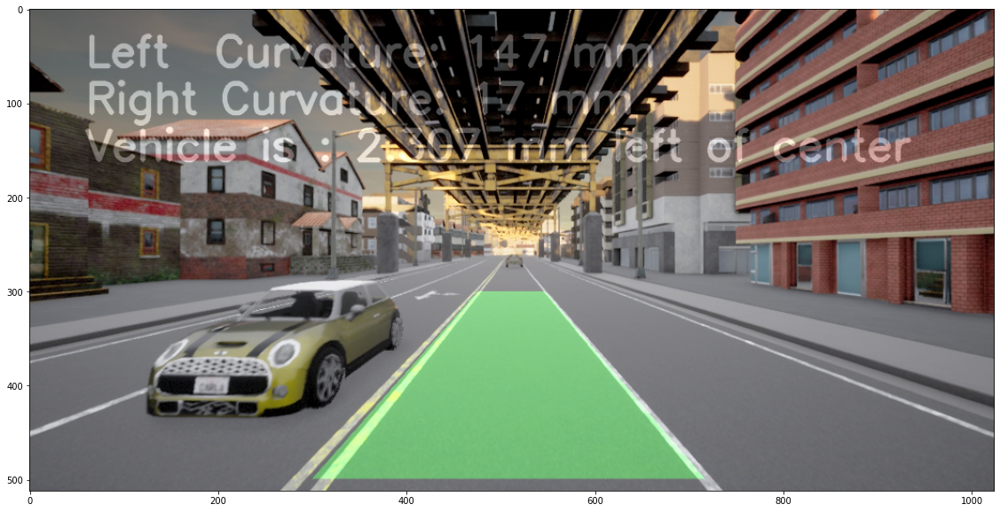

In [150]:
for i in range(8):
  path = './carla_images/rgb/00'+str(i)+'/00.jpg'
  test_images_path = glob.glob(path)
  for img_full_path in test_images_path:
    #read image
    img = mpimg.imread(img_full_path)
    result = pipeline(img)
    plt.figure(figsize=(20,10))
    plt.imshow(result)